<a href="https://colab.research.google.com/github/anajikadam/NLP/blob/main/EDA_TextData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Exploratory Data Analysis and Visualization for Text Data**

### Women's E-Commerce Clothing Reviews
kaggle [link](https://www.kaggle.com/nicapotato/womens-ecommerce-clothing-reviews)

helper [link](https://www.kaggle.com/azizozmen/nlp-comparative-rnn-dl-models-with-detailed-eda)

In [ ]:
# !pip install chart-studio
# !!pip install plotly
# !pip install scattertext
#  !python -m spacy download en_core_web_lg

In [ ]:
!pip install -U spacy
!python -m spacy download en_core_web_sm

     |████████████████████████████████| 13.9 MB 4.4 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [ ]:
import spacy

from pprint import pprint
# import en_core_web_sm

# spacy.prefer_gpu()
nlp = spacy.load("en_core_web_sm")

In [ ]:
import pandas as pd
import numpy as np

from textblob import TextBlob

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
import warnings 
warnings.filterwarnings('ignore')

import matplotlib
import matplotlib.pyplot as plt

import seaborn as sns
%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (10.0, 6.0)

import plotly.graph_objs as go
import plotly as py
import cufflinks

pd.options.display.max_columns = 30
from IPython.core.interactiveshell import InteractiveShell
import plotly.figure_factory as ff
InteractiveShell.ast_node_interactivity = 'all'
from plotly.offline import iplot
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')

from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE

from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
output_notebook()

from collections import Counter
import scattertext as st

from pprint import pprint
# import en_core_web_sm
# nlp = spacy.load('en_core_web_md')

In [ ]:
path = r"/content/drive/MyDrive/Colab/NLP/Data/"

df = pd.read_csv(path + 'Womens Clothing E-Commerce Reviews.csv')
df.head()

,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [ ]:
print("Shape of Dataframe : ", df.shape)

Shape of Dataframe :  (23486, 11)


In [ ]:
df.drop('Unnamed: 0', axis=1, inplace=True)  # drop 1 column Unnamed: 0

In [ ]:
print("List of columns : ", list(df.columns))

List of columns :  ['Clothing ID', 'Age', 'Title', 'Review Text', 'Rating', 'Recommended IND', 'Positive Feedback Count', 'Division Name', 'Department Name', 'Class Name']


### About the Features:

1) Clothing ID: Integer Categorical variable that refers to the specific piece being reviewed.

2) Age: Positive Integer variable of the reviewers age.

3) Title: String variable for the title of the review.

4) Review Text: String variable for the review body.

5) Rating: Positive Ordinal Integer variable for the product score granted by the customer from 1 Worst, to 5 Best.

6) Recommended IND: Binary variable stating where the customer recommends the product where 1 is recommended, 0 is not recommended.

7) Positive Feedback Count: Positive Integer documenting the number of other customers who found this review positive.

8) Division Name: Categorical name of the product high level division.

9) Department Name: Categorical name of the product department name.

10) Class Name: Categorical name of the product class name.

### pre-processing Data:
- Remove the “Title” feature.
- Remove the rows where “Review Text” were missing.
- Clean “Review Text” column.
- Using TextBlob to calculate sentiment polarity : 

  which lies in the range of [-1,1]
   where 1 means positive sentiment and
   -1 means a negative sentiment.
- Create new feature for the length of the review.
- Create new feature for the word count of the review.

In [ ]:
a = 0 
for i in range(a, a+4):
    print(df['Review Text'][i])
    print(df['Rating'][i])
    print(df['Recommended IND'][i])
    print()

Absolutely wonderful - silky and sexy and comfortable
4
1

Love this dress!  it's sooo pretty.  i happened to find it in a store, and i'm glad i did bc i never would have ordered it online bc it's petite.  i bought a petite and am 5'8".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite.
5
1

I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c
3
0

I love, love, love this jumpsuit. it's fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments!
5

In [ ]:
df.drop('Title', axis=1, inplace=True)   # Drop Title columns
df = df[~df['Review Text'].isnull()]     # drop rows which has null value in Review Text columns

In [ ]:
print("After drop columns and rows Shape of Dataframe : ", df.shape)

After drop columns and rows Shape of Dataframe :  (22641, 9)


### Preprocessing

In [ ]:
def preprocess(ReviewText):
    ReviewText = ReviewText.str.replace("(<br/>)", "")
    ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
    ReviewText = ReviewText.str.replace('(&amp)', '')
    ReviewText = ReviewText.str.replace('(&gt)', '')
    ReviewText = ReviewText.str.replace('(&lt)', '')
    ReviewText = ReviewText.str.replace('(\xa0)', ' ')  
    return ReviewText

# preprocess function remove HTML tags     
df['Review Text'] = preprocess(df['Review Text'])

### Add new Columns:

- polarity :  sentiment polarity [-1, 1]
- review_len : lengths of the review 
- word_count : review word count

In [ ]:
df['polarity'] = df['Review Text'].map(lambda text: TextBlob(text).sentiment.polarity)
df['review_len'] = df['Review Text'].astype(str).apply(len)
df['word_count'] = df['Review Text'].apply(lambda x: len(str(x).split()))

In [ ]:
print("After Add new columns Shape of Dataframe : ", df.shape)

After Add new columns Shape of Dataframe :  (22641, 12)


In [ ]:
df.head()

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,polarity,review_len,word_count
0,767,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,0.633333,53,8
1,1080,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses,0.339583,303,62
2,1077,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,0.073675,500,98
3,1049,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants,0.550000,124,22
4,847,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,0.512891,192,36


To preview whether the sentiment polarity score works, we randomly select 5 reviews with the highest sentiment polarity score i.e. (1)
And also check for lowest polarity score i.e. (0)

In [ ]:
print('5 random reviews with the highest positive sentiment polarity: \n')
cl = df.loc[df.polarity == 1, ['Review Text']].sample(5).values
for c in cl:
    print(c[0])

5 random reviews with the highest positive sentiment polarity: 

Perfect! can't believe how inexpensive this is for the look. it looks just like it does on the model. i can't wait to wear it on my vacation.
Fits perfect.
This is the perfect holiday dress. my best purchase of the season!
If there ever was the perfect feminine dress, this would be it .
Beautiful blend of colors and the texture of the shirt is so soft...perfect fall weather garment!


In [ ]:
print('5 random reviews with the most neutral sentiment(zero) polarity: \n')
cl = df.loc[df.polarity == 0, ['Review Text']].sample(5).values
for c in cl:
    print(c[0])

5 random reviews with the most neutral sentiment(zero) polarity: 

Sadly, this dress was trashed after wearing it for an hour. it snagged on everything -- my watch, my purse, my necklace. i had to go home, change, and return the dress later. impractical fabric ruined an otherwise lovely dress.
So much extra fabric. not something i would recommend buying online.
Unforgiving to even your smallest imperfections.
This dress overwhelmed me. i'm 5 feet tall and the print and material just took over.
Only one sleeve is folded twice and sewed. meh.


In [ ]:
df.polarity.min()  # find min polarity 

-0.9750000000000001

In [ ]:
df.loc[df.polarity == -0.97500000000000009]

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,polarity,review_len,word_count
14754,868,52,"Cut out design, no seems or hems.\r\n very dis...",1,0,0,General,Tops,Knits,-0.975,65,11
20502,870,61,Received this product with a gaping hole in it...,1,0,1,General,Tops,Knits,-0.975,121,21


In [ ]:
print('2 reviews with the most negative polarity: \n')
minPol = df.polarity.min()
cl = df.loc[df.polarity == minPol, ['Review Text']].sample(2).values
for c in cl:
    print(c[0])

2 reviews with the most negative polarity: 

Received this product with a gaping hole in it. very disappointed in the quality and the quality control at the warehouse
Cut out design, no seems or hems.
 very disappointed in retailer


### Univariate visualization with Plotly

Single-variable or univariate visualization is the simplest type of visualization which consists of observations on only a single characteristic or attribute.

Univariate visualization includes histogram, bar plots and line charts.
The distribution of review sentiment polarity score

#### Dist plot of review polarity score

In [ ]:
import IPython
from IPython.display import Image 


def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))
  
IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)

In [ ]:
df['polarity'].iplot(
    kind='hist',
    bins=50,
    xTitle='polarity',
    linecolor='black',
    yTitle='count',
    title='Sentiment Polarity Distribution')

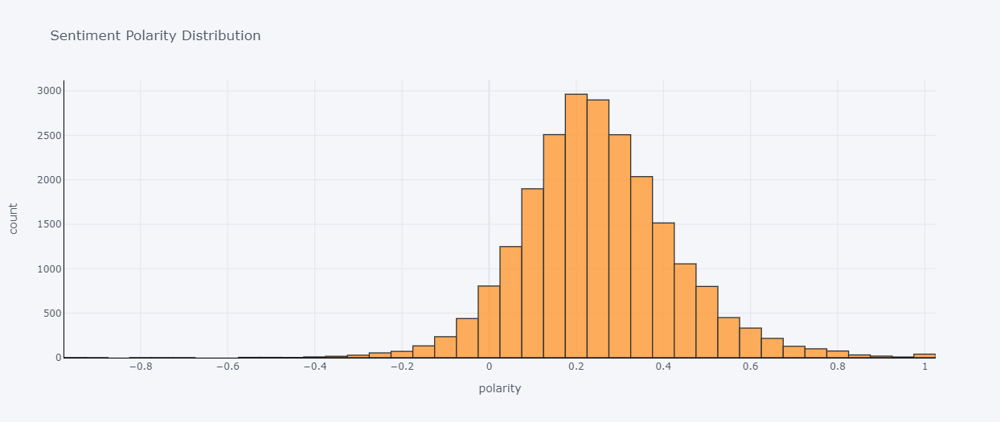

In [ ]:
fig1 = Image(filename='fig1.png')
display(fig1)

### Vast majority of the polarity are greater than 0, means most of them are positive.

### Distribution of ratings

In [ ]:
df['Rating'].iplot(
    kind='hist',
    xTitle='rating',
    linecolor='black',
    yTitle='count',
    title='Review Rating Distribution')

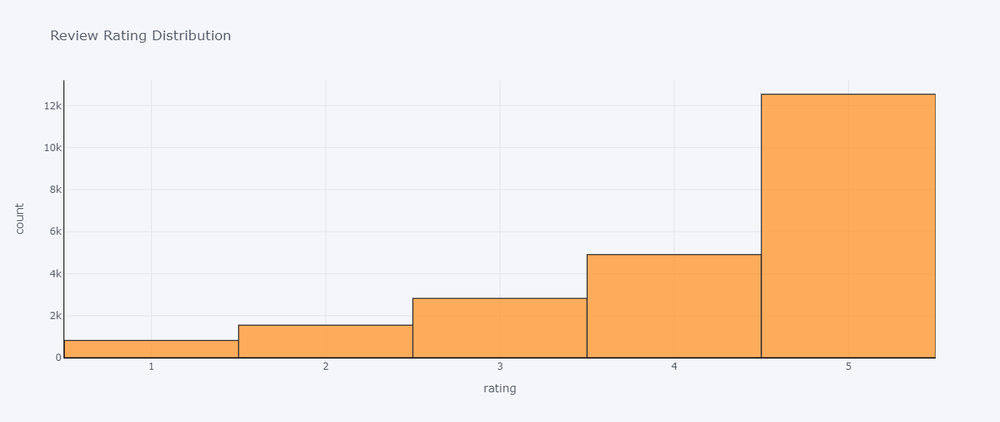

In [ ]:
fig1 = Image(filename='fig2.png')
display(fig1)

### The ratings are in align with the polarity, that is, most of the ratings are at 4 or 5 range.

In [ ]:
df['Age'].iplot(
    kind='hist',
    bins=50,
    xTitle='age',
    linecolor='black',
    yTitle='count',
    title='Reviewers Age Distribution')

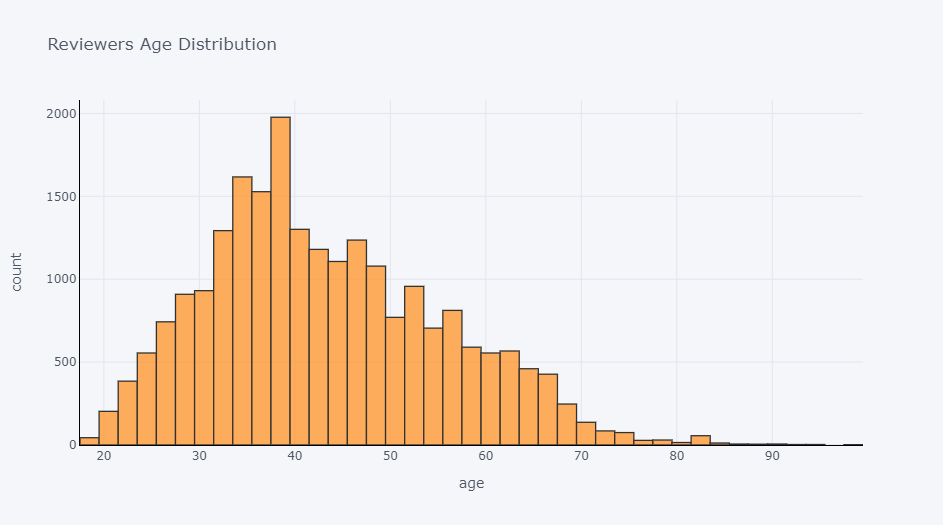

In [ ]:
fig1 = Image(filename='fig3.png')
display(fig1)

### Most reviewers are in their 30s to 40s.

In [ ]:
df['review_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='review length',
    linecolor='black',
    yTitle='count',
    title='Review Text Length Distribution')

In [ ]:
df['word_count'].iplot(
    kind='hist',
    bins=100,
    xTitle='word count',
    linecolor='black',
    yTitle='count',
    title='Review Text Word Count Distribution')

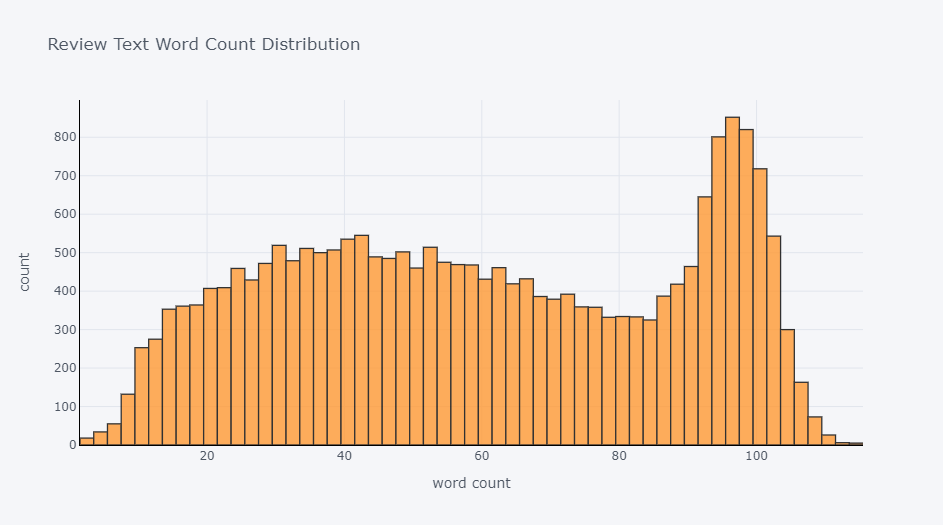

In [ ]:
fig1 = Image(filename='fig4.png')
display(fig1)

## There were quite number of people like to leave long reviews.

In [ ]:
df.groupby('Division Name').count()['Clothing ID'].iplot(kind='bar', yTitle='Count', linecolor='black', opacity=0.8,
                                                          title='Bar chart of Division Name', xTitle='Division Name')

In [ ]:
df.groupby('Department Name').count()['Clothing ID'].sort_values(ascending=False).iplot(kind='bar', yTitle='Count', linecolor='black', opacity=0.8,
                                                           title='Bar chart of Department Name', xTitle='Department Name')

In [ ]:
df.groupby('Class Name').count()['Clothing ID'].sort_values(ascending=False).iplot(kind='bar', yTitle='Count', linecolor='black', opacity=0.8,
                                                           title='Bar chart of Class Name', xTitle='Class Name')

## 2D Density Jointplot of Age and Rating

In [ ]:
# trace1 = go.Scatter(
#     x=df['Age'], y=df['Rating'], mode='markers', name='points',
#     marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
# )
# trace2 = go.Histogram2dContour(
#     x=df['Age'], y=df['Rating'], name='density', ncontours=20,
#     colorscale='Hot', reversescale=True, showscale=False
# )
# trace3 = go.Histogram(
#     x=df['Age'], name='Age density',
#     marker=dict(color='rgb(102,0,0)'),
#     yaxis='y2'
# )
# trace4 = go.Histogram(
#     y=df['Rating'], name='Rating density', marker=dict(color='rgb(102,0,0)'),
#     xaxis='x2'
# )
# data = [trace1, trace2, trace3, trace4]

# layout = go.Layout(
#     showlegend=False,
#     autosize=False,
#     width=600,
#     height=550,
#     xaxis=dict(
#         domain=[0, 0.85],
#         showgrid=False,
#         zeroline=False
#     ),
#     yaxis=dict(
#         domain=[0, 0.85],
#         showgrid=False,
#         zeroline=False
#     ),
#     margin=dict(
#         t=50
#     ),
#     hovermode='closest',
#     bargap=0,
#     xaxis2=dict(
#         domain=[0.85, 1],
#         showgrid=False,
#         zeroline=False
#     ),
#     yaxis2=dict(
#         domain=[0.85, 1],
#         showgrid=False,
#         zeroline=False
#     )
# )

# fig = go.Figure(data=data, layout=layout)
# iplot(fig, filename='2dhistogram-2d-density-plot-subplots')

People in their 30s are likely to give high ratings.

### 2D Density Jointplot of Age and Sentiment Polarity

In [ ]:
trace1 = go.Scatter(
    x=df['Age'], y=df['polarity'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['Age'], y=df['polarity'], name='density', ncontours=20,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['Age'], name='Age density',
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['polarity'], name='Sentiment Polarity density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=600,
    height=550,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='2dhistogram-2d-density-plot-subplots')

There were few people are very positive or very negative, people who give neutral to positive reviews are more likely to be in their 30s. Probably people at these age are likely to be active.

Ratings between age groups

In [ ]:
df[['Rating', 'Age']].iplot(secondary_y='Age', secondary_y_title='Age',
    kind='box', yTitle='Rating', title='Box Plot of Age and Rating')

### 2D Density Jointplot of Sentiment Polarity vs. Rating

In [ ]:
trace1 = go.Scatter(
    x=df['polarity'], y=df['Rating'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['polarity'], y=df['Rating'], name='density', ncontours=20,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['polarity'], name='Sentiment polarity density',
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['Rating'], name='Rating density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=600,
    height=550,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='2dhistogram-2d-density-plot-subplots')

### Distribution of sentiment polarity score by recommendations

In [ ]:
x1 = df.loc[df['Recommended IND'] == 1, 'polarity']
x0 = df.loc[df['Recommended IND'] == 0, 'polarity']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay', title='Distribution of Sentiment polarity of reviews based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='overlaid histogram')

It is obvious that reviews have higher polarity score are more likely to be recommended.

Apparently, the polarity score for recommended reviews is higher than the polarity score for not recommended reviews.

### Distribution of review ratings based on recommendations

In [ ]:
x1 = df.loc[df['Recommended IND'] == 1, 'Rating']
x0 = df.loc[df['Recommended IND'] == 0, 'Rating']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay', title='Distribution of Sentiment polarity of reviews based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='overlaid histogram')

Recommended reviews have higher ratings than otherwise.

### Top unigrams before removing stop words

In [ ]:

def get_top_n_words(corpus, n=None):
    vec = CountVectorizer().fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]


    
common_words = get_top_n_words(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)
df1 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

the 76166
it 49284
and 49009
is 30641
this 25762
to 24583
in 20723
but 16556
on 15328
for 14000
of 13429
with 12803
was 12221
so 12023
my 11028
dress 10567
that 10014
not 9799
love 8951
size 8772


In [ ]:
df1.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 words in review before removing stop words')

### Top unigrams after removing stop words

In [ ]:
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer(stop_words = 'english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

    
common_words = get_top_n_words(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)
df2 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

dress 10567
love 8951
size 8772
fit 7325
like 7149
wear 6439
great 6117
just 5608
fabric 4798
small 4729
color 4605
look 4039
really 3925
ordered 3850
little 3775
perfect 3774
flattering 3519
soft 3343
comfortable 3060
cute 3042


In [ ]:
df2.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 words in review after removing stop words')

### Top bigrams before removing stop words

In [ ]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

    
common_words = get_top_n_bigram(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)
df3 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

in the 7169
it is 6169
and the 5614
this dress 4758
on the 4338
of the 3932
and it 3725
it was 3100
this top 2939
this is 2750
the fabric 2655
love the 2641
love this 2333
is very 2321
to wear 2267
but it 2196
the dress 2180
with the 2057
for me 2026
but the 1974


In [ ]:
df3.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 bigrams in review before removing stop words')

### Top bigrams after removing stop words

In [ ]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

    
common_words = get_top_n_bigram(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)
df4 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

true size 1347
love dress 766
usually wear 691
looks great 620
fit perfectly 609
size small 540
fits perfectly 489
usual size 479
look like 425
just right 423
ordered size 375
love love 374
looks like 373
runs large 367
highly recommend 365
super cute 363
wear size 361
fabric soft 350
feel like 349
fit great 348


In [ ]:
df4.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 bigrams in review after removing stop words')

### Top trigrams before removing stop words


In [ ]:
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_trigram(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)
df5 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

true to size 1316
the fabric is 1291
this dress is 1115
the material is 886
in the store 728
on the model 725
the fit is 693
this top is 667
the color is 625
love this dress 605
tried it on 574
it is very 572
and it is 569
and it was 537
in the back 528
up or down 518
the dress is 511
to wear it 490
love this top 480
the colors are 472


In [ ]:
df5.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 trigrams in review before removing stop words')

### Top trigrams after removing stop words

In [ ]:

def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_trigram(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)
df6 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

fits true size 280
fit true size 229
runs true size 148
love love love 143
usually wear size 136
ordered usual size 107
does run large 95
really wanted love 94
wanted love dress 88
usually wear small 80
small fit perfectly 77
looks great jeans 70
fit like glove 69
usually wear medium 68
normally wear size 68
small fits perfectly 65
size fit perfectly 65
fits like glove 65
usual size small 64
usually wear xs 63


In [ ]:
df6.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 trigrams in review after removing stop words')

### Top 20 part-of-speech tagging of review corpus


In [ ]:
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [ ]:
blob = TextBlob(str(df['Review Text']))
pos_df = pd.DataFrame(blob.tags, columns = ['word' , 'pos'])
pos_df = pos_df.pos.value_counts()[:20]
pos_df.iplot(
    kind='bar',
    xTitle='POS',
    yTitle='count', 
    title='Top 20 Part-of-speech tagging for review corpus')

### Distribution of review lengths by recommendations

In [ ]:
x1 = df.loc[df['Recommended IND'] == 1, 'review_len']
x0 = df.loc[df['Recommended IND'] == 0, 'review_len']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode = 'group', title='Distribution of Review Lengths Based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='stacked histogram')

Distribution of word count by recommendations

In [ ]:
x1 = df.loc[df['Recommended IND'] == 1, 'word_count']
x0 = df.loc[df['Recommended IND'] == 0, 'word_count']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode = 'group', title='Distribution of Word Count Based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='grouped histogram')

Recommended reviews tend to be more lengthier than those not recommended reviews.

In [ ]:
y0 = df.loc[df['Division Name'] == 'General']['polarity']
y1 = df.loc[df['Division Name'] == 'General Petite']['polarity']
y2 = df.loc[df['Division Name'] == 'Initmates']['polarity']

trace0 = go.Box(
    y=y0,
    name = 'General',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'General Petite',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Initmates',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
data = [trace0, trace1, trace2]
layout = go.Layout(
    title = "Sentiment Polarity Boxplot of Division Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Sentiment Polarity Boxplot of Division Name")

The highest sentiment polarity score was achieved by all of three divisions, and the lowest sentiment polarity score was collected by General division.

We don't see any significant difference in terms of sentiment polarity between division names.

In [ ]:
y0 = df.loc[df['Department Name'] == 'Tops']['polarity']
y1 = df.loc[df['Department Name'] == 'Dresses']['polarity']
y2 = df.loc[df['Department Name'] == 'Bottoms']['polarity']
y3 = df.loc[df['Department Name'] == 'Intimate']['polarity']
y4 = df.loc[df['Department Name'] == 'Jackets']['polarity']
y5 = df.loc[df['Department Name'] == 'Trend']['polarity']

trace0 = go.Box(
    y=y0,
    name = 'Tops',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Dresses',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Bottoms',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Intimate',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Jackets',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Trend',
    marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Sentiment Polarity Boxplot of Department Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Sentiment Polarity Boxplot of Department Name")

In [ ]:
y0 = df.loc[df['Department Name'] == 'Tops']['review_len']
y1 = df.loc[df['Department Name'] == 'Dresses']['review_len']
y2 = df.loc[df['Department Name'] == 'Bottoms']['review_len']
y3 = df.loc[df['Department Name'] == 'Intimate']['review_len']
y4 = df.loc[df['Department Name'] == 'Jackets']['review_len']
y5 = df.loc[df['Department Name'] == 'Trend']['review_len']

trace0 = go.Box(
    y=y0,
    name = 'Tops',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Dresses',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Bottoms',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Intimate',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Jackets',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Trend',
    marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Review length Boxplot of Department Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Review Length Boxplot of Department Name")

In [ ]:
y0 = df.loc[df['Department Name'] == 'Tops']['Rating']
y1 = df.loc[df['Department Name'] == 'Dresses']['Rating']
y2 = df.loc[df['Department Name'] == 'Bottoms']['Rating']
y3 = df.loc[df['Department Name'] == 'Intimate']['Rating']
y4 = df.loc[df['Department Name'] == 'Jackets']['Rating']
y5 = df.loc[df['Department Name'] == 'Trend']['Rating']

trace0 = go.Box(
    y=y0,
    name = 'Tops',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Dresses',
    marker = dict(
       color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
 y=y2,
    name = 'Bottoms',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Intimate',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Jackets',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Trend',
   marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Rating Boxplot of Department Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Rating Boxplot of Department Name")

## Topic Modeling with LSA

In [ ]:
reindexed_data = df['Review Text']
tfidf_vectorizer = TfidfVectorizer(stop_words='english', use_idf=True, smooth_idf=True)
reindexed_data = reindexed_data.values
document_term_matrix = tfidf_vectorizer.fit_transform(reindexed_data)

In [ ]:
n_topics = 6
lsa_model = TruncatedSVD(n_components=n_topics)
lsa_topic_matrix = lsa_model.fit_transform(document_term_matrix)

In [ ]:
def get_keys(topic_matrix):
    '''
    returns an integer list of predicted topic 
    categories for a given topic matrix
    '''
    keys = topic_matrix.argmax(axis=1).tolist()
    return keys

def keys_to_counts(keys):
    '''
    returns a tuple of topic categories and their 
    accompanying magnitudes for a given list of keys
    '''
    count_pairs = Counter(keys).items()
    categories = [pair[0] for pair in count_pairs]
    counts = [pair[1] for pair in count_pairs]
    return (categories, counts)

In [ ]:
lsa_keys = get_keys(lsa_topic_matrix)
lsa_categories, lsa_counts = keys_to_counts(lsa_keys)

In [ ]:
def get_top_n_words(n, keys, document_term_matrix, tfidf_vectorizer):
    '''
    returns a list of n_topic strings, where each string contains the n most common 
    words in a predicted category, in order
    '''
    top_word_indices = []
    for topic in range(n_topics):
        temp_vector_sum = 0
        for i in range(len(keys)):
            if keys[i] == topic:
                temp_vector_sum += document_term_matrix[i]
        temp_vector_sum = temp_vector_sum.toarray()
        top_n_word_indices = np.flip(np.argsort(temp_vector_sum)[0][-n:],0)
        top_word_indices.append(top_n_word_indices)   
    top_words = []
    for topic in top_word_indices:
        topic_words = []
        for index in topic:
            temp_word_vector = np.zeros((1,document_term_matrix.shape[1]))
            temp_word_vector[:,index] = 1
            the_word = tfidf_vectorizer.inverse_transform(temp_word_vector)[0][0]
            topic_words.append(the_word.encode('ascii').decode('utf-8'))
        top_words.append(" ".join(topic_words))         
    return top_words

In [ ]:
top_n_words_lsa = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)

for i in range(len(top_n_words_lsa)):
    print("Topic {}: ".format(i+1), top_n_words_lsa[i])

Topic 1:  dress size love
Topic 2:  dress beautiful love
Topic 3:  great love comfortable
Topic 4:  size small true
Topic 5:  shirt cute love
Topic 6:  sweater love beautiful


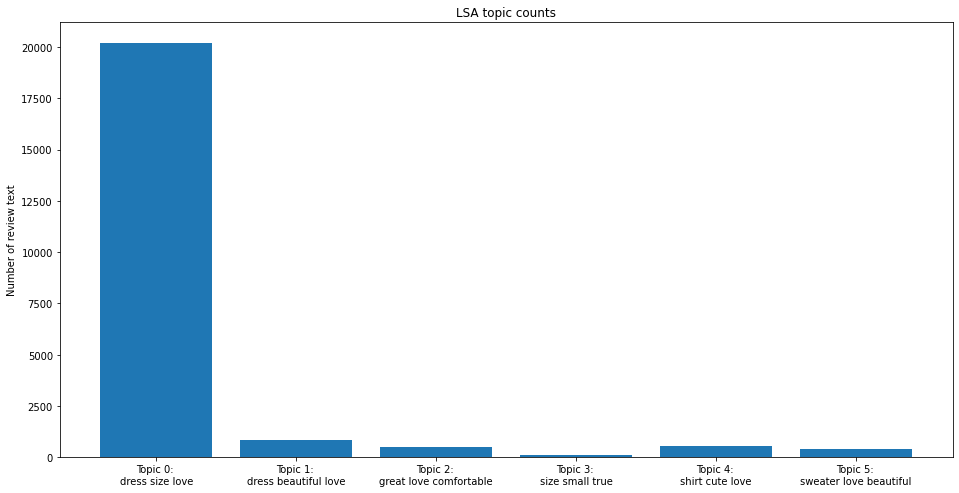

In [ ]:
top_3_words = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)
labels = ['Topic {}: \n'.format(i) + top_3_words[i] for i in lsa_categories]

fig, ax = plt.subplots(figsize=(16,8))
ax.bar(lsa_categories, lsa_counts);
ax.set_xticks(lsa_categories);
ax.set_xticklabels(labels);
ax.set_ylabel('Number of review text');
ax.set_title('LSA topic counts');
plt.show();

In [ ]:
tsne_lsa_model = TSNE(n_components=2, perplexity=50, learning_rate=100, 
                        n_iter=2000, verbose=1, random_state=0, angle=0.75)
tsne_lsa_vectors = tsne_lsa_model.fit_transform(lsa_topic_matrix)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 22641 samples in 0.026s...
[t-SNE] Computed neighbors for 22641 samples in 2.704s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22641
[t-SNE] Computed conditional probabilities for sample 2000 / 22641
[t-SNE] Computed conditional probabilities for sample 3000 / 22641
[t-SNE] Computed conditional probabilities for sample 4000 / 22641
[t-SNE] Computed conditional probabilities for sample 5000 / 22641
[t-SNE] Computed conditional probabilities for sample 6000 / 22641
[t-SNE] Computed conditional probabilities for sample 7000 / 22641
[t-SNE] Computed conditional probabilities for sample 8000 / 22641
[t-SNE] Computed conditional probabilities for sample 9000 / 22641
[t-SNE] Computed conditional probabilities for sample 10000 / 22641
[t-SNE] Computed conditional probabilities for sample 11000 / 22641
[t-SNE] Computed conditional probabilities for sample 12000 / 22641
[t-SNE] Computed conditional probabilities for sa

In [ ]:
def get_mean_topic_vectors(keys, two_dim_vectors):
    '''
    returns a list of centroid vectors from each predicted topic category
    '''
    mean_topic_vectors = []
    for t in range(n_topics):
        reviews_in_that_topic = []
        for i in range(len(keys)):
            if keys[i] == t:
                reviews_in_that_topic.append(two_dim_vectors[i])    
        
        reviews_in_that_topic = np.vstack(reviews_in_that_topic)
        mean_review_in_that_topic = np.mean(reviews_in_that_topic, axis=0)
        mean_topic_vectors.append(mean_review_in_that_topic)
    return mean_topic_vectors

In [ ]:
colormap = np.array([
    "#1f77b4", "#aec7e8", "#ff7f0e", "#ffbb78", "#2ca02c",
    "#98df8a", "#d62728", "#ff9896", "#9467bd", "#c5b0d5",
    "#8c564b", "#c49c94", "#e377c2", "#f7b6d2", "#7f7f7f",
    "#c7c7c7", "#bcbd22", "#dbdb8d", "#17becf", "#9edae5" ])
colormap = colormap[:n_topics]

In [ ]:
top_3_words_lsa = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)
lsa_mean_topic_vectors = get_mean_topic_vectors(lsa_keys, tsne_lsa_vectors)

plot = figure(title="t-SNE Clustering of {} LSA Topics".format(n_topics), plot_width=700, plot_height=700)
plot.scatter(x=tsne_lsa_vectors[:,0], y=tsne_lsa_vectors[:,1], color=colormap[lsa_keys])

for t in range(n_topics):
    label = Label(x=lsa_mean_topic_vectors[t][0], y=lsa_mean_topic_vectors[t][1], 
                  text=top_3_words_lsa[t], text_color=colormap[t])
    plot.add_layout(label)
    
show(plot)

GlyphRenderer(id='1038', ...)

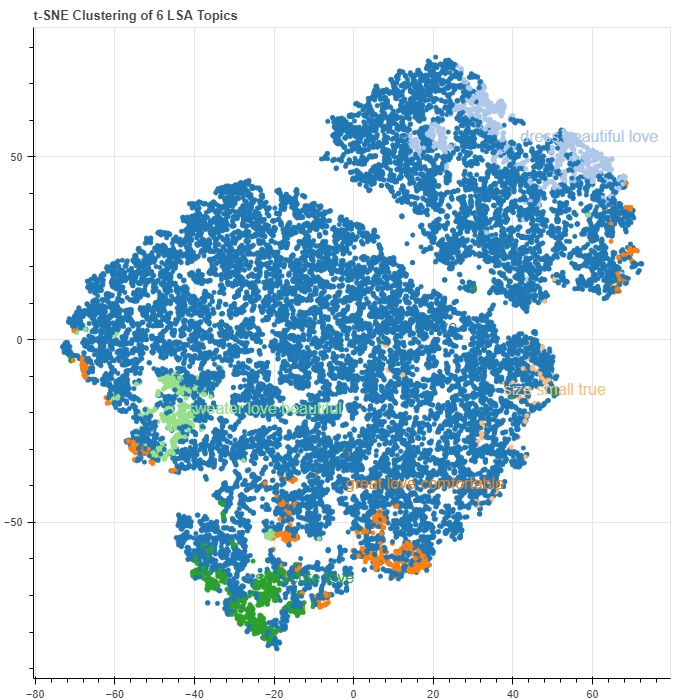

In [ ]:
fig1 = Image(filename='fig44.png')
display(fig1)

In [ ]:
corpus = st.CorpusFromPandas(df, category_col='Department Name', text_col='Review Text', nlp=nlp).build()
print(list(corpus.get_scaled_f_scores_vs_background().index[:10]))

['flattering', 'sweater', 'boxy', 'flowy', 'leggings', 'xs', 'waist', 'dress', 'blouse', 'comfy']


In [ ]:
term_freq_df = corpus.get_term_freq_df()
term_freq_df['Tops Score'] = corpus.get_scaled_f_scores('Tops')
pprint(list(term_freq_df.sort_values(by='Tops Score', ascending=False).index[:10]))

['this shirt',
 'the shirt',
 'this blouse',
 'this top',
 'shirt is',
 'this sweater',
 'sweater is',
 'blouse',
 'the sweater',
 'shirt']


In [ ]:
term_freq_df['Dresses Score'] = corpus.get_scaled_f_scores('Dresses')
pprint(list(term_freq_df.sort_values(by='Dresses Score', ascending=False).index[:10]))

['this dress',
 'the dress',
 'dress is',
 'dress in',
 'dress for',
 'dress and',
 'dress',
 'dress was',
 'dress but',
 'dress to']
